<a href="https://colab.research.google.com/github/IYashCanCode/Detectron2-Mask-Detection/blob/main/Detectron2_Mask_Detection.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

<h1><b>Mask Detection Using Detecton - 2<br>

<br> Project Group : 4 <br>
<br> By:<br>
Neha Chaudhary <br>
Yash Kumar

<b><h1> Installing and loading necessary modules

In [ ]:
!git clone https://github.com/facebookresearch/detectron2.git

Cloning into 'detectron2'...
remote: Enumerating objects: 15297, done.
remote: Counting objects: 100% (22/22), done.
remote: Compressing objects: 100% (21/21), done.
remote: Total 15297 (delta 7), reused 7 (delta 1), pack-reused 15275
Receiving objects: 100% (15297/15297), 6.18 MiB | 21.31 MiB/s, done.
Resolving deltas: 100% (11122/11122), done.


In [ ]:
!pip install 'git+https://github.com/facebookresearch/detectron2.git'

  Cloning https://github.com/facebookresearch/detectron2.git to /tmp/pip-req-build-lor099ze
  Running command git clone --filter=blob:none --quiet https://github.com/facebookresearch/detectron2.git /tmp/pip-req-build-lor099ze
  Resolved https://github.com/facebookresearch/detectron2.git to commit e9f7e2ba15abd7badcb05ef6f5076f06b36a9c5b
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 50.2/50.2 kB 2.1 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 79.5/79.5 kB 6.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 154.5/154.5 kB 8.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.7/1.7 MB 13.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 117.0/117.0 kB 17.3 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for detectron2: filename=detectron2-0.6-cp310-cp310-linux_x86_64.whl size=6119655 sha256=a62e27f2a6c170d428d2a94998359

In [ ]:
from detectron2 import model_zoo
from detectron2.engine import DefaultTrainer, DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import ColorMode, Visualizer
from detectron2.structures import BoxMode
from detectron2.data.datasets import register_coco_instances
from detectron2.data import MetadataCatalog, DatasetCatalog
from detectron2.data import build_detection_test_loader
from detectron2.evaluation import COCOEvaluator, inference_on_dataset, LVISEvaluator
from detectron2.utils.logger import setup_logger
setup_logger()

import os
import cv2
import pickle
import random
import matplotlib.pyplot as plt
from google.colab.patches import cv2_imshow

<h3><b>Registering Training images coco format

In [ ]:
from detectron2.data.datasets import register_coco_instances
register_coco_instances("OD_Mask_train", {}, "/content/sample_train/train_.json", "/content/sample_train/images")
register_coco_instances("OD_Mask_test", {}, "/content/sample_test/test_images.json", "/content/sample_test/images")

In [ ]:
OD_Mask_metadata_train = MetadataCatalog.get("OD_Mask_train")
OD_Mask_metadata_test = MetadataCatalog.get("OD_Mask_test")
dataset_dicts_train = DatasetCatalog.get("OD_Mask_train")
dataset_dicts_test = DatasetCatalog.get("OD_Mask_test")

WARNING [12/28 15:20:19 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[12/28 15:20:19 d2.data.datasets.coco]: Loaded 337 images in COCO format from /content/sample_train/train_.json
WARNING [12/28 15:20:19 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[12/28 15:20:19 d2.data.datasets.coco]: Loaded 22 images in COCO format from /content/sample_test/test_images.json


<h3><b>Visualizing training images

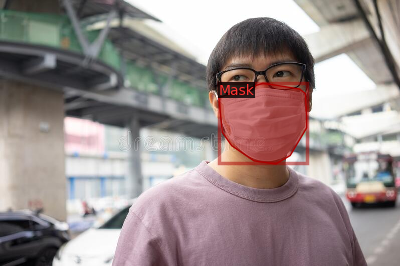

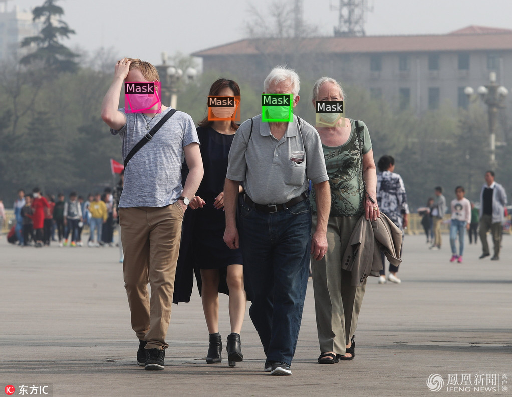

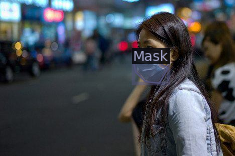

In [ ]:
import random

for d in random.sample(dataset_dicts_train, 3):
    img = cv2.imread(d["file_name"])
    visualizer = Visualizer(img[:, :, ::-1], metadata=OD_Mask_metadata_train, scale=0.5)
    vis = visualizer.draw_dataset_dict(d)
    cv2_imshow(vis.get_image()[:, :, ::-1])

<h3><b>Visualizing testing images

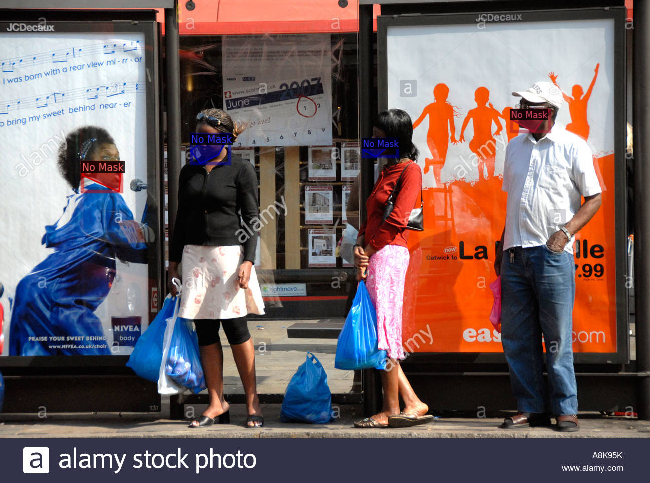

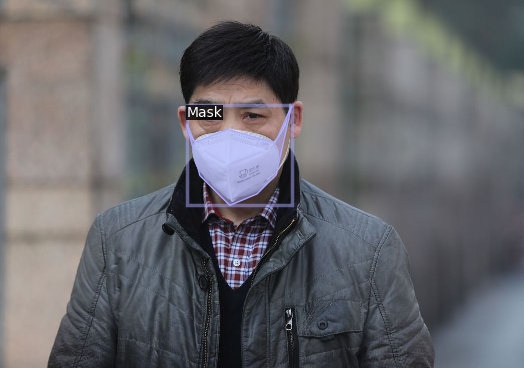

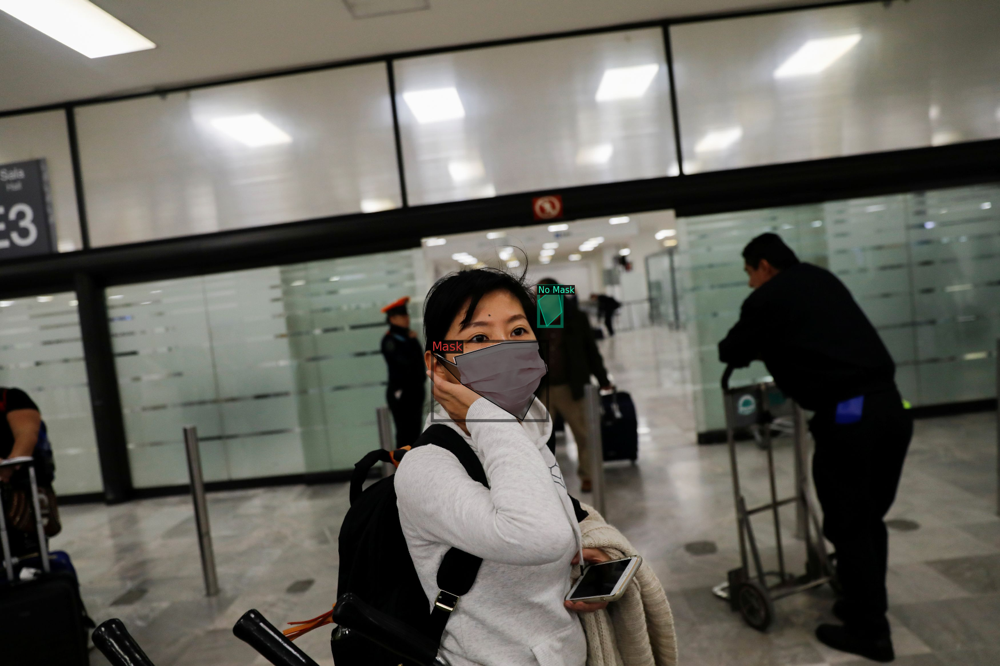

In [ ]:
import random

for d in random.sample(dataset_dicts_test, 3):
    img = cv2.imread(d["file_name"])
    visualizer = Visualizer(img[:, :, ::-1], metadata=OD_Mask_metadata_test, scale=0.5)
    vis = visualizer.draw_dataset_dict(d)
    cv2_imshow(vis.get_image()[:, :, ::-1])

<h3><b>Training Detectron2 detection model on custome dataset of mask detection

In [ ]:
cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file('COCO-Detection/faster_rcnn_R_50_C4_1x.yaml'))
cfg.DATASETS.TRAIN = ("OD_Mask_train",)
cfg.DATASETS.TEST = ("OD_Mask_test",)
cfg.DATALOADER.NUM_WORKERS = 2
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url('COCO-Detection/faster_rcnn_R_50_C4_1x.yaml')
cfg.SOLVER.IMS_PER_BATCH = 2
cfg.SOLVER.BASE_LR = 0.02
cfg.MODEL.DEVICE='cuda'
cfg.SOLVER.MAX_ITER = 500
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 128
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 2

os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)
trainer = DefaultTrainer(cfg)
trainer.resume_or_load(resume=False)
trainer.train()

[12/28 15:20:23 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): ResNet(
    (stem): BasicStem(
      (conv1): Conv2d(
        3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
        (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
      )
    )
    (res2): Sequential(
      (0): BottleneckBlock(
        (shortcut): Conv2d(
          64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False
          (norm): FrozenBatchNorm2d(num_features=256, eps=1e-05)
        )
        (conv1): Conv2d(
          64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
        (conv2): Conv2d(
          64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
        (conv3): Conv2d(
          64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False
          (norm): FrozenBatchNorm2d(num_features=256, eps=1e-05)
 

model_final_721ade.pkl: 136MB [00:00, 199MB/s]                           
roi_heads.box_predictor.bbox_pred.{bias, weight}
roi_heads.box_predictor.cls_score.{bias, weight}


[12/28 15:20:24 d2.engine.train_loop]: Starting training from iteration 0


/usr/local/lib/python3.10/dist-packages/torch/functional.py:504: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at ../aten/src/ATen/native/TensorShape.cpp:3526.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


[12/28 15:20:41 d2.utils.events]:  eta: 0:05:02  iter: 19  total_loss: 1.431  loss_cls: 0.6459  loss_box_reg: 0.5065  loss_rpn_cls: 0.265  loss_rpn_loc: 0.01236    time: 0.6341  last_time: 0.5979  data_time: 0.0355  last_data_time: 0.0161   lr: 0.00077924  max_mem: 2090M
[12/28 15:20:59 d2.utils.events]:  eta: 0:04:34  iter: 39  total_loss: 1.211  loss_cls: 0.3337  loss_box_reg: 0.7686  loss_rpn_cls: 0.08416  loss_rpn_loc: 0.01747    time: 0.6446  last_time: 0.5196  data_time: 0.0774  last_data_time: 0.0133   lr: 0.0015784  max_mem: 2090M
[12/28 15:21:11 d2.utils.events]:  eta: 0:04:12  iter: 59  total_loss: 0.7863  loss_cls: 0.1818  loss_box_reg: 0.5303  loss_rpn_cls: 0.04089  loss_rpn_loc: 0.01176    time: 0.6189  last_time: 0.5501  data_time: 0.0262  last_data_time: 0.0156   lr: 0.0023776  max_mem: 2090M
[12/28 15:21:22 d2.utils.events]:  eta: 0:03:57  iter: 79  total_loss: 0.7751  loss_cls: 0.1995  loss_box_reg: 0.4756  loss_rpn_cls: 0.02158  loss_rpn_loc: 0.01116    time: 0.6006  

<h3><b>Joining custom weights to the detectron model

In [ ]:
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.75
cfg.DATASETS.TEST = ("OD_Mask_test", )
predictor = DefaultPredictor(cfg)

[12/28 15:25:32 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from ./output/model_final.pth ...


In [ ]:
%load_ext tensorboard
%tensorboard --logdir output

<IPython.core.display.Javascript object>

<h3><b>Predicting the images using custom mask detection detectron2 model

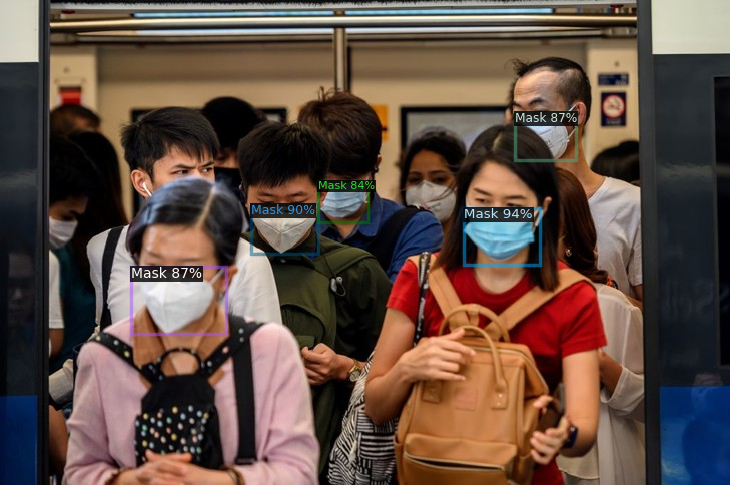

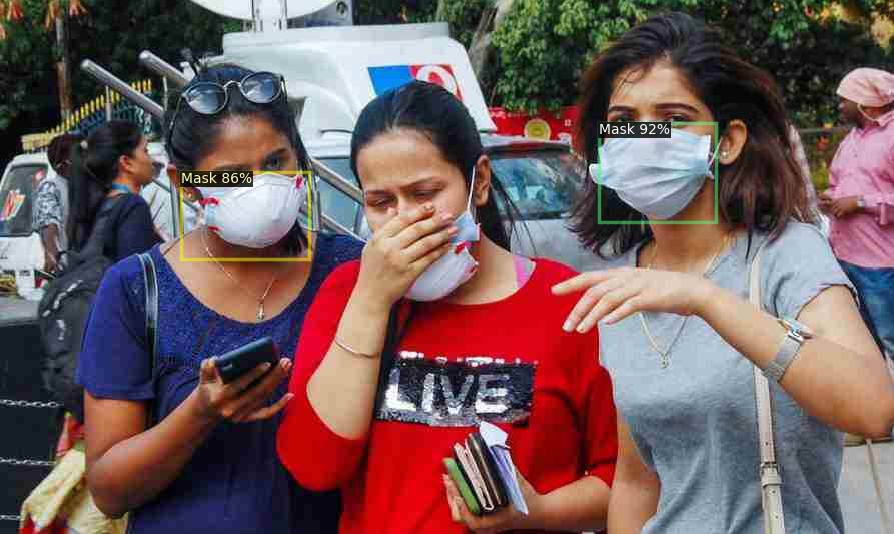

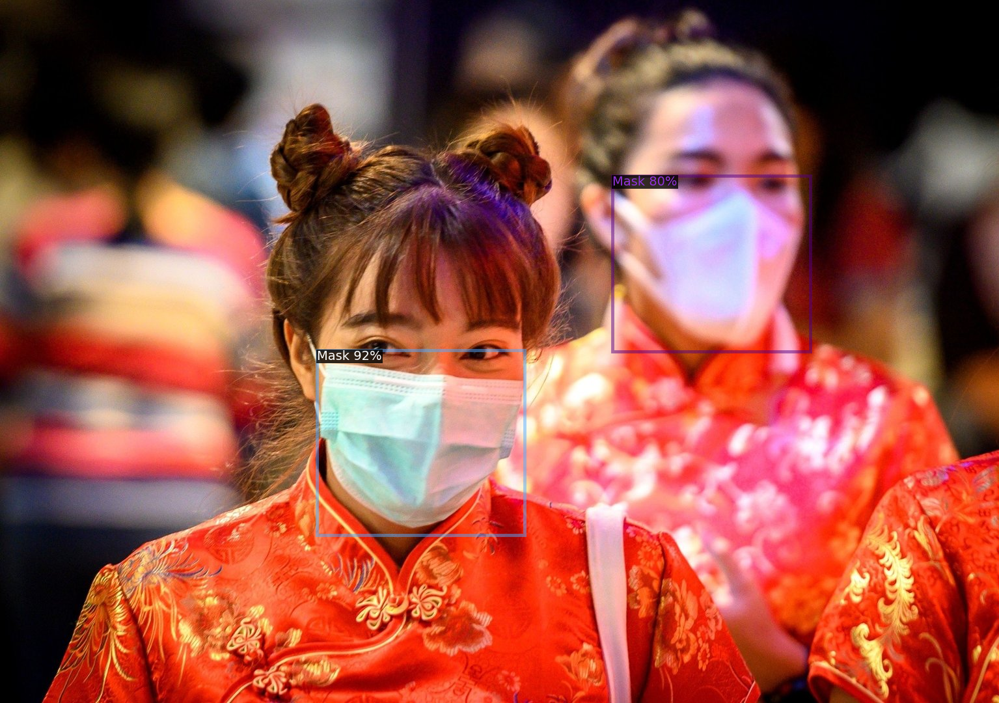

In [ ]:
for d in random.sample(dataset_dicts_train, 3):
    im = cv2.imread(d["file_name"])
    outputs = predictor(im)
    v = Visualizer(im[:, :, ::-1],
                   metadata=OD_Mask_metadata_train,
                   scale=1.,
                   instance_mode=ColorMode.IMAGE
    )
    v = v.draw_instance_predictions(outputs["instances"].to("cpu"))
    cv2_imshow(v.get_image()[:, :, ::-1])

<h3><b>Predicting new unseen images from custom mask detection detectron2 model

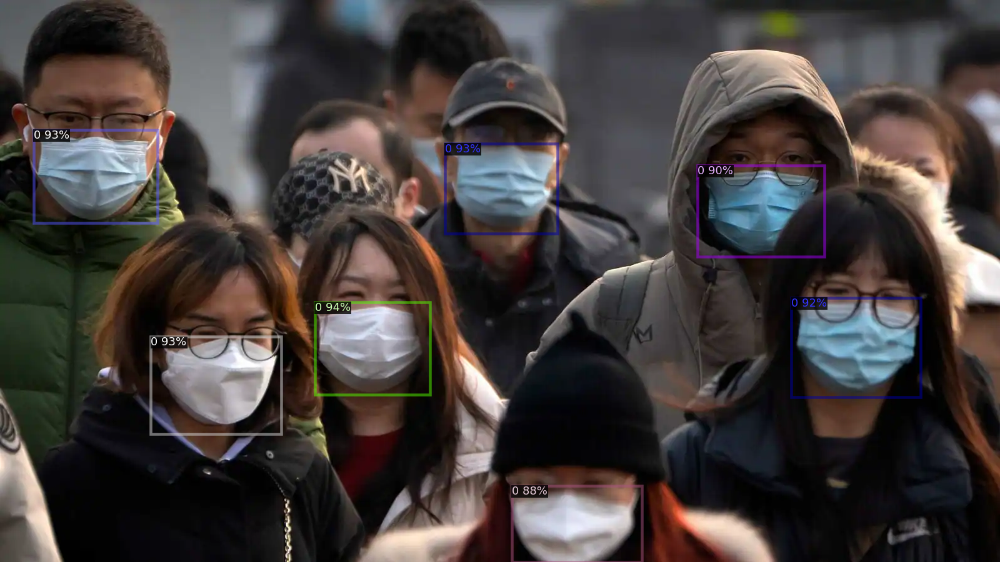

In [ ]:
im = cv2.imread('/content/face_masks_1676434071914_1676434072173_1676434072173.jpg')
outputs = predictor(im)
v = Visualizer(im[:, :, ::-1],
                metadata={},
                scale=1.,
                instance_mode=ColorMode.IMAGE
)
v = v.draw_instance_predictions(outputs["instances"].to("cpu"))
cv2_imshow(v.get_image()[:, :, ::-1])

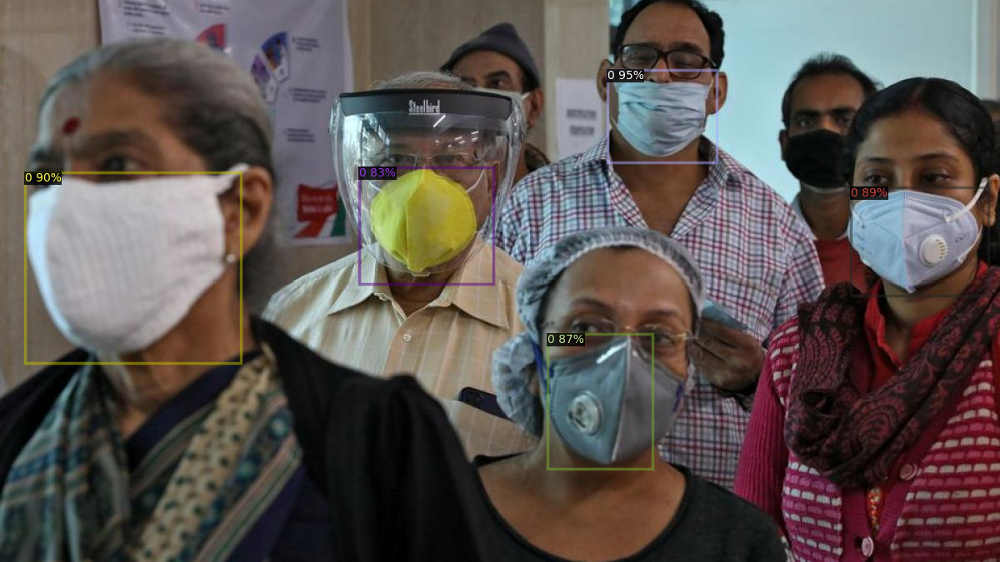

In [ ]:
im = cv2.imread('/content/covid_masks-sixteen_nine.jpeg')
outputs = predictor(im)
v = Visualizer(im[:, :, ::-1],
                metadata={},
                scale=1.,
                instance_mode=ColorMode.IMAGE
)
v = v.draw_instance_predictions(outputs["instances"].to("cpu"))
cv2_imshow(v.get_image()[:, :, ::-1])

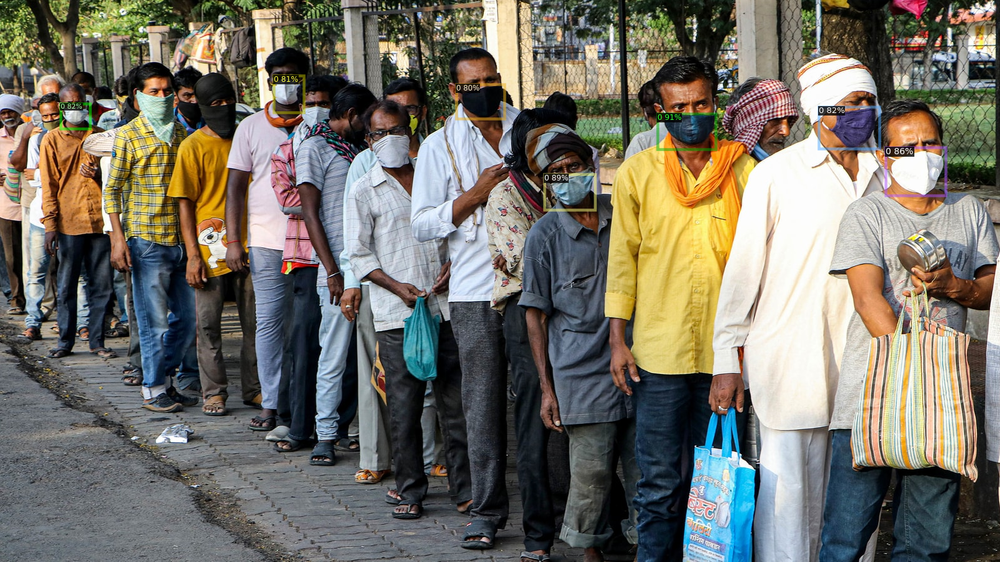

In [ ]:
im = cv2.imread('/content/PTI05_17_2021_000164A_1621562268101_1621562291587.jpg')
outputs = predictor(im)
v = Visualizer(im[:, :, ::-1],
                metadata={},
                scale=1.,
                instance_mode=ColorMode.IMAGE
)
v = v.draw_instance_predictions(outputs["instances"].to("cpu"))
cv2_imshow(v.get_image()[:, :, ::-1])

<h3><b>Evaluting the model performance using COCOEvaluator

In [ ]:
evaluator = COCOEvaluator("OD_Mask_train", cfg, False, output_dir="./output/")
val_loader = build_detection_test_loader(cfg, "OD_Mask_train")
inference_on_dataset(trainer.model, val_loader, evaluator)

WARNING [12/28 15:45:24 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass in explicit arguments instead.
WARNING [12/28 15:45:24 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[12/28 15:45:24 d2.data.datasets.coco]: Loaded 337 images in COCO format from /content/sample_train/train_.json
[12/28 15:45:24 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[12/28 15:45:24 d2.data.common]: Serializing the dataset using: <class 'detectron2.data.common._TorchSerializedList'>
[12/28 15:45:24 d2.data.common]: Serializing 337 elements to byte tensors and concatenating them all ...
[12/28 15:45:24 d2.data.common]: Serialized dataset takes 0.27 MiB
[12/28 15:45:24 d2.evaluation.evaluator]: Start inference on 337 batches
[12/28 15:45:30 d2.evaluation.evaluato

OrderedDict([('bbox',
              {'AP': 27.988864970507414,
               'AP50': 59.314993980378006,
               'AP75': 22.21743205641819,
               'APs': 15.046212582333885,
               'APm': 28.89146099014679,
               'APl': 30.036818733731014,
               'AP-Mask': 45.39728309303836,
               'AP-No Mask': 10.580446847976463})])

In [ ]:
evaluator = COCOEvaluator("OD_Mask_test", cfg, False, output_dir="./output/")
val_loader = build_detection_test_loader(cfg, "OD_Mask_test")
inference_on_dataset(trainer.model, val_loader, evaluator)

WARNING [12/28 15:47:59 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass in explicit arguments instead.
WARNING [12/28 15:47:59 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[12/28 15:47:59 d2.data.datasets.coco]: Loaded 22 images in COCO format from /content/sample_test/test_images.json
[12/28 15:47:59 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[12/28 15:47:59 d2.data.common]: Serializing the dataset using: <class 'detectron2.data.common._TorchSerializedList'>
[12/28 15:47:59 d2.data.common]: Serializing 22 elements to byte tensors and concatenating them all ...
[12/28 15:47:59 d2.data.common]: Serialized dataset takes 0.02 MiB
[12/28 15:47:59 d2.evaluation.evaluator]: Start inference on 22 batches
[12/28 15:48:04 d2.evaluation.evaluat

OrderedDict([('bbox',
              {'AP': 23.213979401121144,
               'AP50': 53.5495623738198,
               'AP75': 12.164073550212166,
               'APs': 19.09203662301714,
               'APm': 23.222797166594486,
               'APl': 39.75900090009001,
               'AP-Mask': 38.21906833540497,
               'AP-No Mask': 8.208890466837314})])